In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from cycler import cycler
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
import numpy as np
import scipy.stats as sps
import json, pickle, os, corner, glob, sys
import enterprise.signals.utils as utils
from enterprise.pulsar import Pulsar
import arviz as az
from collections import defaultdict
import pandas as pd


import warnings
warnings.filterwarnings('ignore')

In [3]:
import la_forge.diagnostics as dg
import la_forge.core as co
from la_forge.rednoise import plot_rednoise_spectrum, plot_free_spec
from la_forge.utils import epoch_ave_resid

In [4]:
color_cycle_wong = ['#000000','#E69F00','#009E73','#56B4E9','#0072B2','#F0E442','#D55E00','#CC79A7']
mpl.rcParams['axes.prop_cycle'] = cycler(color=color_cycle_wong)

In [5]:
current_path = os.getcwd()
splt_path = current_path.split("/")
top_path_idx = splt_path.index("akaiser")
#top_path_idx = splt_path.index("nanograv")
top_dir = "/".join(splt_path[0 : top_path_idx + 1])

In [6]:
e_e_path = top_dir + "/enterprise_extensions/"
sys.path.insert(0, e_e_path)
from enterprise_extensions.timing_2 import get_astrometric_priors
import nltm_plot_utils_v2 as nltm

In [7]:
psr_name = 'J1713+0747'#'J1640+2224'#'J2317+1439' 'J1909-3744'

psrlist = [psr_name]
datareleases = ['5yr','9yr','11yr','12p5yr']

psrs = nltm.get_psrs(psrlist,datareleases)
pardict = nltm.get_pardict(psrs,datareleases)

5yr
9yr
11yr
12p5yr


In [8]:
for psr,dataset in zip(psrs,datareleases):
    print(dataset)
    for par,vals,errs in zip(psr.fitpars[1:],psr.t2pulsar.vals(),psr.t2pulsar.errs()):
        if "DMX" in ["".join(list(x)[0:3]) for x in par.split("_")][0]:
            pass
        elif "FD" in ["".join(list(x)[0:2]) for x in par.split("_")][0]:
            pass
        elif "JUMP" in ["".join(list(x)[0:4]) for x in par.split("_")][0]:
            pass
        elif par in ["Offset","TASC"]:
            pass
        elif par in ["RAJ", "DECJ", "ELONG", "ELAT", "BETA", "LAMBDA"]:
            pass
        #elif par in ["PMRA", "PMDEC", "PMELONG", "PMELAT", "PMBETA", "PMLAMBDA"]:
        #    pass
        else:
            print(' ',par)
            print('   ',vals,errs)

5yr
  F0
    218.81184391573411206 8.2318648026160937587e-13
  F1
    -4.0838870557588695152e-16 4.059861176739534831e-21
  PMRA
    4.9495832773943767165 0.0073763748777635066226
  PMDEC
    -3.9561191030518207596 0.01230556340341780984
  PX
    0.8644410479194279903 0.042622501490259472046
  PB
    67.825129927327620735 2.3908091222700000605e-09
  T0
    51997.580336920117258 0.00063407423062225673916
  A1
    32.342420536194508365 3.539933510244799816e-07
  OM
    176.20170422637885203 0.0033654724946374390757
  ECC
    7.49370012945140325e-05 1.3315737602300000334e-09
  M2
    0.32586445386667143168 0.029607063929948700814
  KOM
    94.13850363118360461 3.3778313915603432882
  KIN
    70.2083431754865638 1.5177998199629727516
9yr
  F0
    218.8118438109020758 3.9500000000000002083e-14
  F1
    -4.083901734659e-16 9.13317251979799968e-22
  PMELONG
    5.2596 0.0023999999999999997898
  PMELAT
    -3.4418 0.0051999999999999997613
  PX
    0.8478 0.030900000000000000383
  SINI
    0.95

In [9]:
px_priors = get_astrometric_priors(current_path+'/parallaxes.json')
tm_val = float(px_priors[psrlist[0]]['PI'][0])
tm_sigma = 2.0*float(px_priors[psrlist[0]]['PI'][0])
tm_lower_bound = 3.0*float(px_priors[psrlist[0]]['eminus'][0])
tm_upper_bound = 3.0*float(px_priors[psrlist[0]]['eplus'][0])

# Make Lists of Chain Directories to Load

In [10]:
chaindir_list = []
#indices = np.arange(1,6,1)
indices = [1]
#big_chaindir = os.getcwd()+'/chains/{}_all_var'.format(psr)
for i in indices:
    for datarelease in datareleases:
        if datarelease != '12p5yr':
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_RV_True_WV_True_PX_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_bounded_normal_RV_True_WV_True_PX_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_bounded_normal_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
        else:
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_{}_tm_{}'.format(psr_name,datarelease,psr_name,'DE436',2))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_{}_tm_{}'.format(psr_name,datarelease,psr_name,'DE438',2))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_{}_PX_tm_{}'.format(psr_name,datarelease,psr_name,'DE436',2))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_{}_PX_tm_{}'.format(psr_name,datarelease,psr_name,'DE438',2))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_{}_nltm_ltm_{}'.format(psr_name,datarelease,psr_name,'DE436',3))
        """
        if datarelease in ['5yr','9yr'] and i in [1,3,4]:
            if i == 1:
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_RV_True_WV_True_PX_tm_{}'.format(psr_name,datarelease,psr_name,i))
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_bounded_normal_RV_True_WV_True_PX_tm_{}'.format(psr_name,datarelease,psr_name,i))
            else:
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_uniform_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_bounded_normal_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
        elif datarelease in ['11yr'] and i in [1,2]:
            if i == 1:
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_RV_True_WV_True_PX_tm_{}'.format(psr_name,datarelease,psr_name,i))
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_bounded_normal_RV_True_WV_True_PX_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_uniform_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_bounded_normal_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
        """
[print(chaindir) for chaindir in chaindir_list];

/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/5yr/J1713+0747_uniform_RV_True_WV_True_PX_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/5yr/J1713+0747_bounded_normal_RV_True_WV_True_PX_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/5yr/J1713+0747_uniform_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/5yr/J1713+0747_bounded_normal_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/9yr/J1713+0747_uniform_RV_True_WV_True_PX_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/9yr/J1713+0747_bounded_normal_RV_True_WV_True_PX_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/9yr/J1713+0747_uniform_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/9yr/J1713+0747_bounded_normal_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1713+0747/chains/11yr/J1713+0747_uniform_RV_True_WV_True_P

# Load Chains and Parameters into a Dictionary

In [11]:
chain_dict = nltm.get_chain_tmparam_dict(chaindir_list)

5yr J1713+0747_uniform_RV_True_WV_True_PX_tm_1 Loaded.      
5yr J1713+0747_bounded_normal_RV_True_WV_True_PX_tm_1 Loaded.      
5yr J1713+0747_uniform_RV_True_WV_True_tm_1 Loaded.      
5yr J1713+0747_bounded_normal_RV_True_WV_True_tm_1 Loaded.      
9yr J1713+0747_uniform_RV_True_WV_True_PX_tm_1 Loaded.      
9yr J1713+0747_bounded_normal_RV_True_WV_True_PX_tm_1 Loaded.      
9yr J1713+0747_uniform_RV_True_WV_True_tm_1 Loaded.      
9yr J1713+0747_bounded_normal_RV_True_WV_True_tm_1 Loaded.      
11yr J1713+0747_uniform_RV_True_WV_True_PX_tm_1 Loaded.      
11yr J1713+0747_bounded_normal_RV_True_WV_True_PX_tm_1 Loaded.      
11yr J1713+0747_uniform_RV_True_WV_True_tm_1 Loaded.      
11yr J1713+0747_bounded_normal_RV_True_WV_True_tm_1 Loaded.      
12p5yr J1713+0747_uniform_DE436_tm_2 Loaded.      
12p5yr J1713+0747_uniform_DE438_tm_2 Loaded.      
12p5yr J1713+0747_uniform_DE436_PX_tm_2 Loaded.      
12p5yr J1713+0747_uniform_DE438_PX_tm_2 Loaded.      
12p5yr J1713+0747_uniform_DE43

In [12]:
for p in chain_dict.keys():
    print(p)
    for px_p in chain_dict[p].keys():
        print('  ',px_p)
        for dset in chain_dict[p][px_p].keys():
            print('    ',dset)
            for subset in chain_dict[p][px_p][dset]['chains']:
                print('      ',np.shape(subset))
print('')
print(pardict.keys())
print(pardict['9yr']['{}'.format(psrlist[0])].keys())
print(pardict['5yr']['{}'.format(''.join(psrlist[0].split('J')[1:]))]['PX'])
print(pardict['9yr']['{}'.format(psrlist[0])]['PX'])
print(pardict['11yr']['{}'.format(psrlist[0])]['PX'])

uniform
   vlbi_priors
     5yr
       (149925, 28)
     9yr
       (149925, 42)
     11yr
       (110325, 40)
   parfile_priors
     5yr
       (149925, 28)
     9yr
       (149925, 42)
     11yr
       (149925, 40)
   parfile_priors_DE436
     12p5yr
       (27150, 42)
       (37425, 42)
   parfile_priors_DE438
     12p5yr
       (27375, 42)
   vlbi_priors_DE436
     12p5yr
       (26850, 42)
   vlbi_priors_DE438
     12p5yr
       (27150, 42)
bounded
   vlbi_priors
     5yr
       (149925, 28)
     9yr
       (149925, 42)
     11yr
       (108075, 40)
   parfile_priors
     5yr
       (149925, 28)
     9yr
       (149925, 42)
     11yr
       (149925, 40)

dict_keys(['5yr', '9yr', '11yr', '12p5yr'])
dict_keys(['F0', 'F1', 'PMELONG', 'PMELAT', 'PX', 'SINI', 'PB', 'T0', 'A1', 'OM', 'ECC', 'XDOT', 'M2'])
{'val': 0.8644410479194279903, 'err': 0.042622501490259472046}
{'val': 0.8478, 'err': 0.030900000000000000383}
{'val': 0.8834797526707823276, 'err': 0.030906743422554013023}


In [13]:
trimmed_chain_dict = nltm.get_trimmed_chain_tmparam_dict(chain_dict)

In [14]:
for p in trimmed_chain_dict.keys():
    print(p)
    for px_p in trimmed_chain_dict[p].keys():
        print('  ',px_p)
        for dset in trimmed_chain_dict[p][px_p].keys():
            print('    ',dset)
            if np.shape(trimmed_chain_dict[p][px_p][dset]['chains'])[0] > 1:
                for subset in trimmed_chain_dict[p][px_p][dset]['chains']:
                    print('      ',np.shape(subset))
            else:
                print('      ',np.shape(trimmed_chain_dict[p][px_p][dset]['chains']))

uniform
   vlbi_priors
     5yr
       (1, 26850, 28)
     9yr
       (1, 26850, 42)
     11yr
       (1, 26850, 40)
   parfile_priors
     5yr
       (1, 26850, 28)
     9yr
       (1, 26850, 42)
     11yr
       (1, 26850, 40)
   parfile_priors_DE436
     12p5yr
       (26850, 42)
       (26850, 42)
   parfile_priors_DE438
     12p5yr
       (1, 26850, 42)
   vlbi_priors_DE436
     12p5yr
       (1, 26850, 42)
   vlbi_priors_DE438
     12p5yr
       (1, 26850, 42)
bounded
   vlbi_priors
     5yr
       (1, 26850, 28)
     9yr
       (1, 26850, 42)
     11yr
       (1, 26850, 40)
   parfile_priors
     5yr
       (1, 26850, 28)
     9yr
       (1, 26850, 42)
     11yr
       (1, 26850, 40)


# Make a List of `la_forge` Cores

In [15]:
core_list = []
for chaindir in chaindir_list:
    core_list.append(co.Core(label='_'.join(chaindir.split('/')[-2:]), chaindir=chaindir))

Appending PTMCMCSampler sampling parameters to end of parameter list.
If unwanted please provide a parameter list.
No burn specified. Burn set to 25% of chain length, 49975
You may change the burn length with core.set_burn()
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Appending PTMCMCSampler sampling parameters to end of parameter list.
If unwanted please provide a parameter list.
No burn specified. Burn set to 25% of chain length, 49975
You may change the burn length with core.set_burn()
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Appending PTMCMCSampler sampling parameters to end of parameter list.
If unwanted please provide a parameter list.
No burn specified. Burn set to 25% of chain length, 49975
You may change the burn length with core.set_burn()
Red noise frequencies must be set before plotting most red noise figures.
Ple

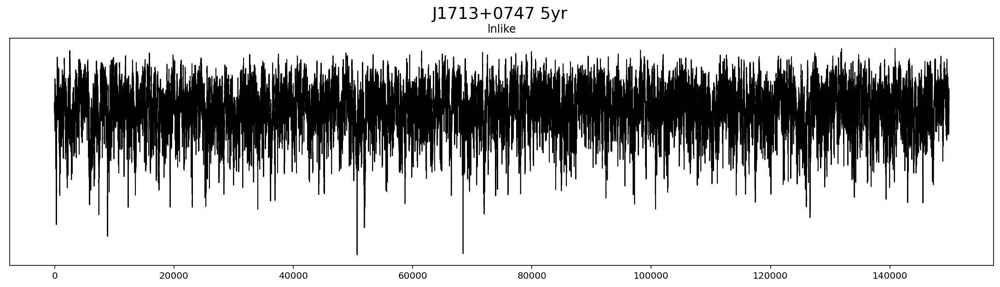

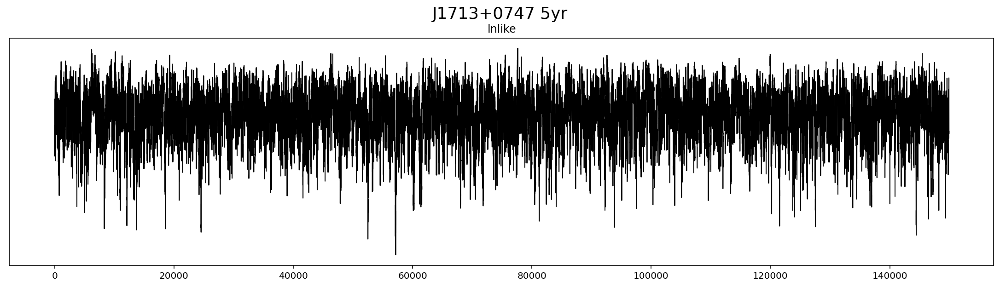

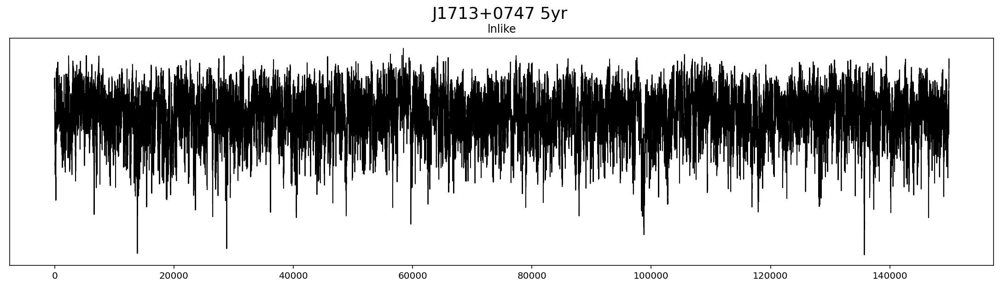

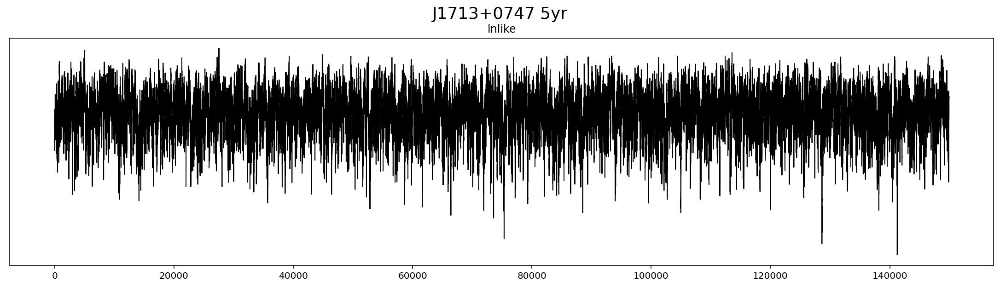

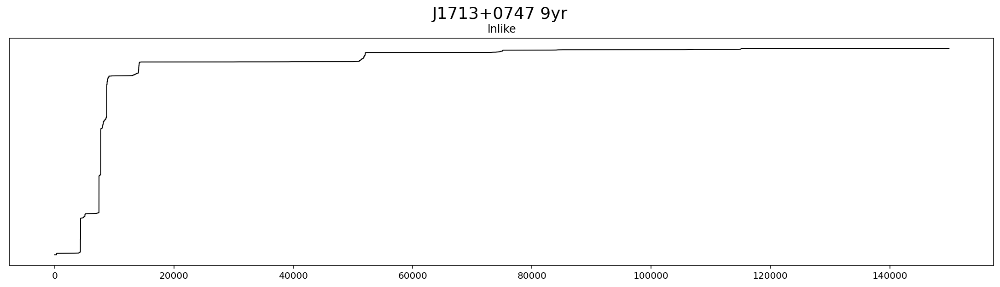

...

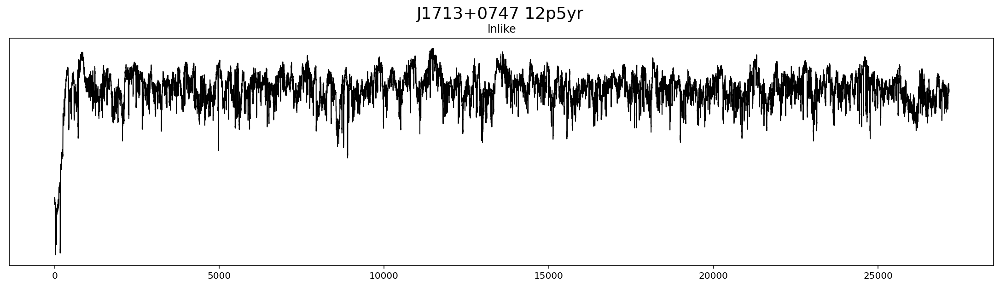

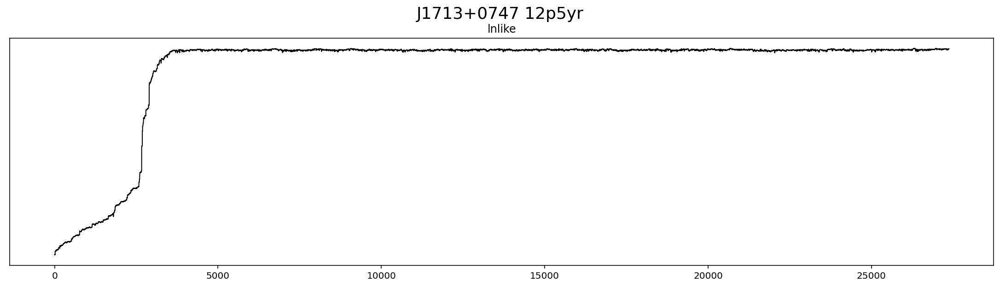

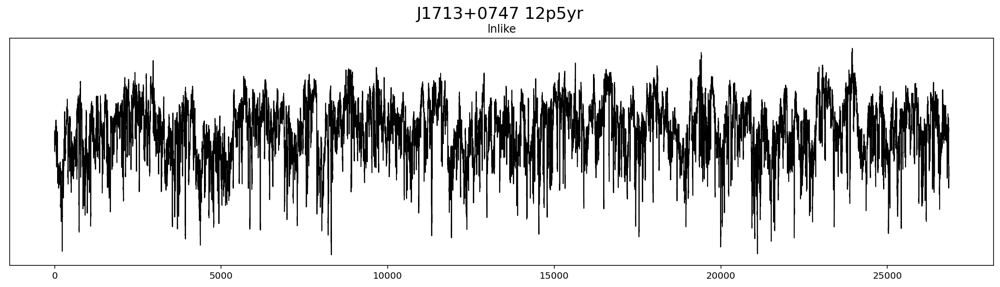

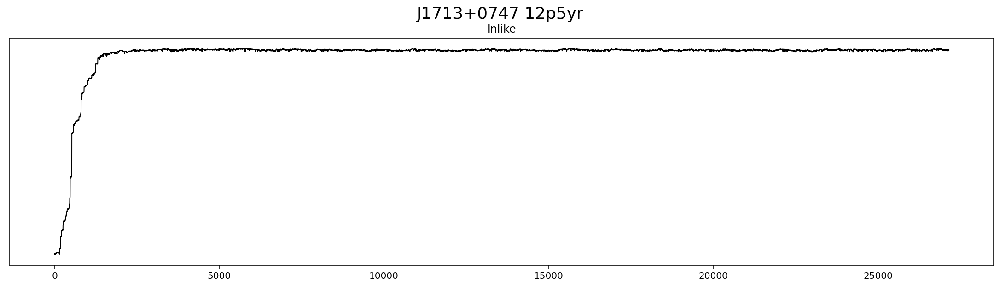

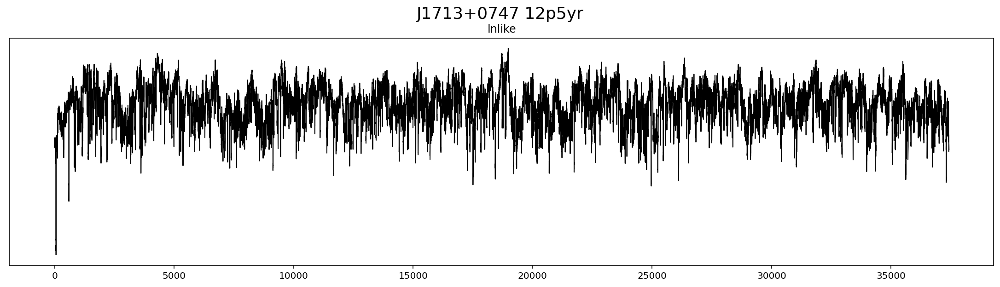

In [16]:
for tmp_core,tmp_chaindir in zip(core_list,chaindir_list):
    dg.plot_chains(tmp_core,pars=['lnlike'],hist=False,
                   suptitle=tmp_chaindir.split('/')[-1].split('_')[0]+' '+tmp_chaindir.split('/')[-2],
                   ncols=1,title_y=1.05)

# Plot Cores with `la_forge`

In [17]:
def plt_selection_of_dataset(dataset,px_prior='all'):
    if px_prior == 'all':
        selection = ['vlbi','parfile']
    else:
        selection = [px_prior]

    core_kwargs = {'hist':True, 'ncols':3, 'title_y':1.07,
                   'suptitle':'{} {} {} Runs'.format(psrlist[0],dataset,px_prior),
                   'bins':10,'hist_kwargs':dict(fill=False),'linewidth':2.}
    misc_kwargs = {'legend_on':True,'legend_loc':(.7,0.05)}
    priors = []
    px_priors = []
    for p in chain_dict.keys():
        for px_p in chain_dict[p].keys():
            for select in selection:
                if select in px_p.split('_'):
                    if dataset in chain_dict[p][px_p].keys():
                        if p not in priors:
                            priors.append(p)
                        if px_p not in px_priors:
                            px_priors.append(px_p)
    if priors and px_priors:
        nltm.plot_common_chains(core_list,chaindir_list,priors,px_priors,dataset,
                                plot_kwargs=core_kwargs,misc_kwargs=misc_kwargs)
    else:
        print(selection,'not in',dataset)

### 5yr Cores

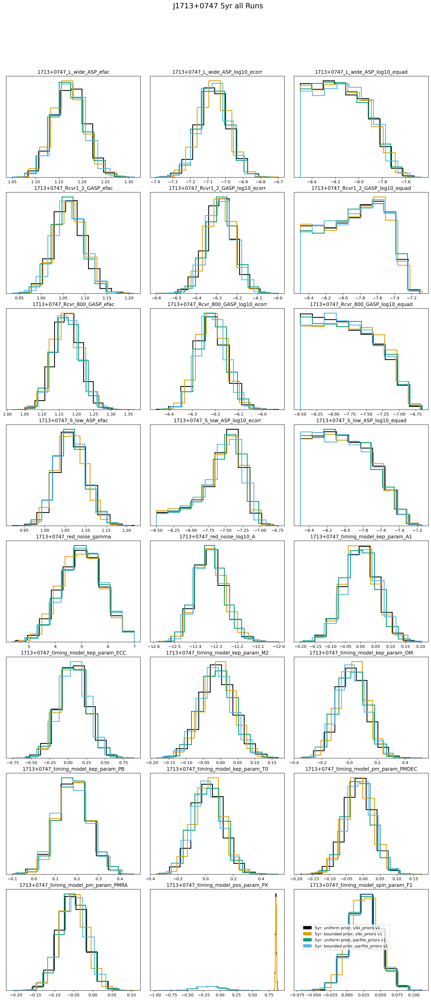

In [18]:
#All Runs
plt_selection_of_dataset('5yr')

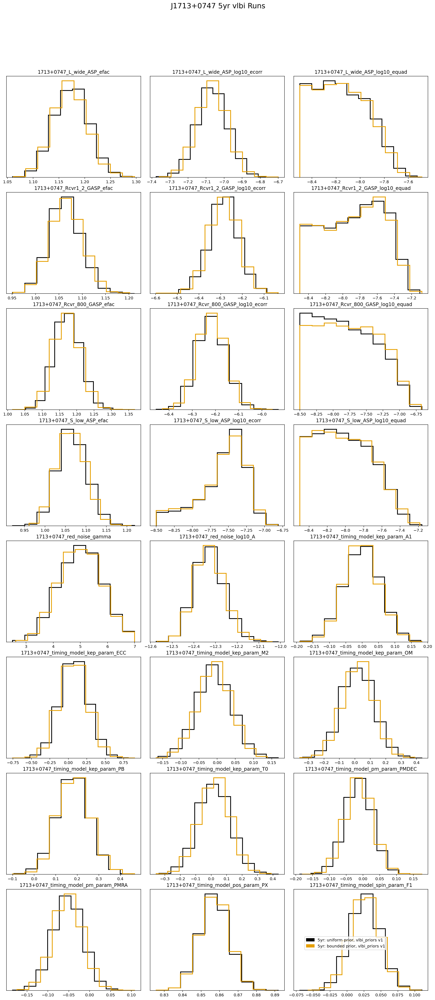

In [19]:
#VLBI Priors
plt_selection_of_dataset('5yr',px_prior='vlbi')

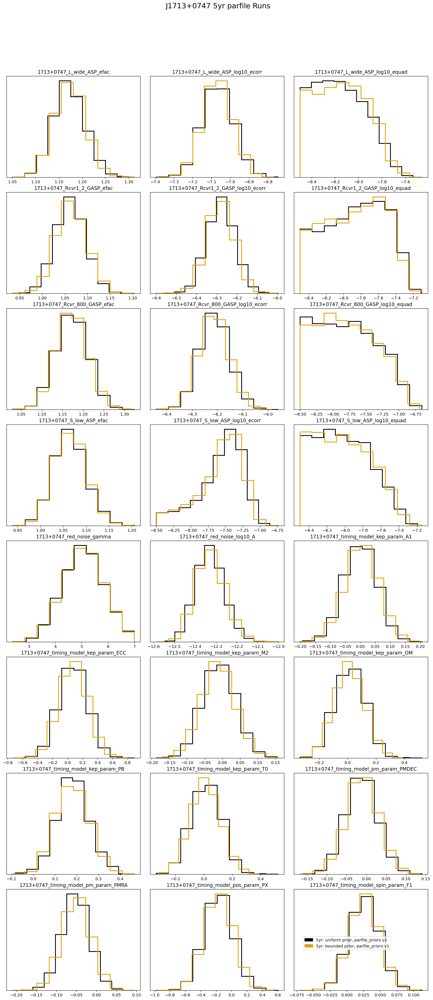

In [20]:
#Non-VLBI Priors
plt_selection_of_dataset('5yr',px_prior='parfile')

### 9yr Cores

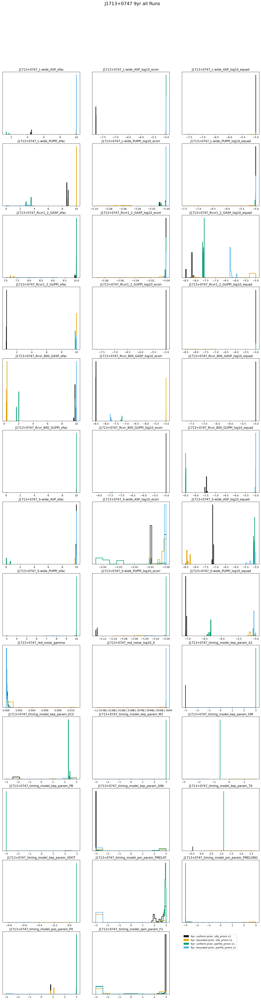

In [21]:
#All Runs
plt_selection_of_dataset('9yr')

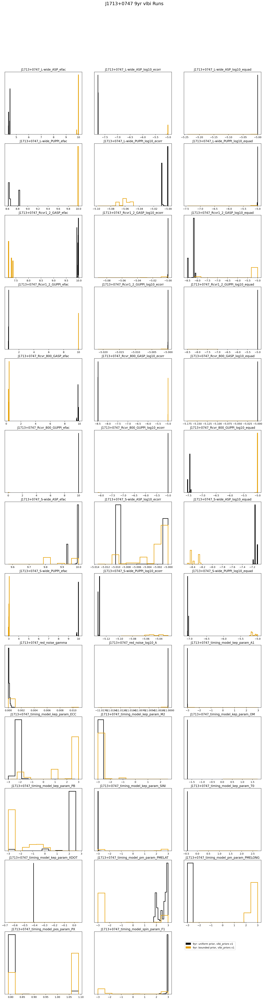

In [22]:
#VLBI Priors
plt_selection_of_dataset('9yr',px_prior='vlbi')

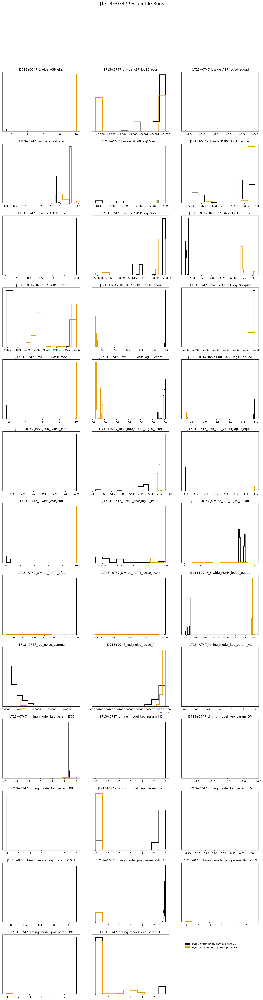

In [23]:
#Non-VLBI Priors
plt_selection_of_dataset('9yr',px_prior='parfile')

### 11yr Cores

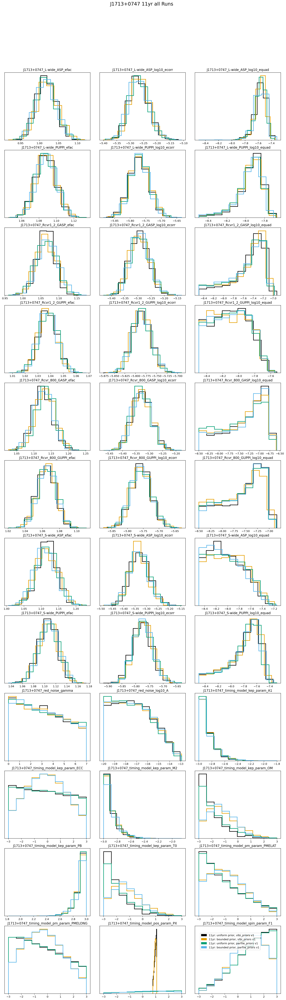

In [24]:
#All Runs
plt_selection_of_dataset('11yr')

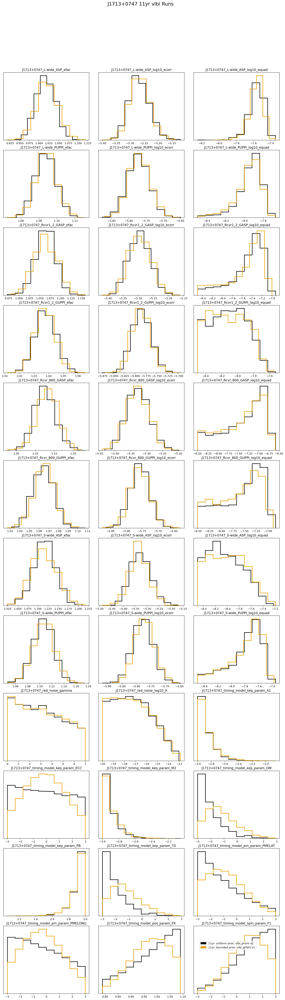

In [25]:
#VLBI Priors
plt_selection_of_dataset('11yr',px_prior='vlbi')

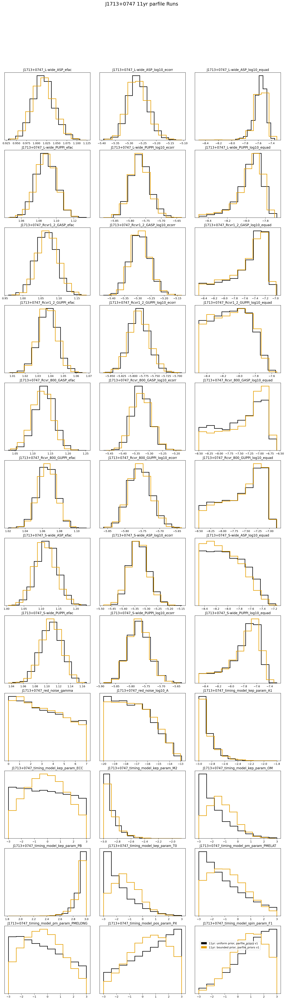

In [26]:
#Non-VLBI Priors
plt_selection_of_dataset('11yr',px_prior='parfile')

### 12.5yr Cores

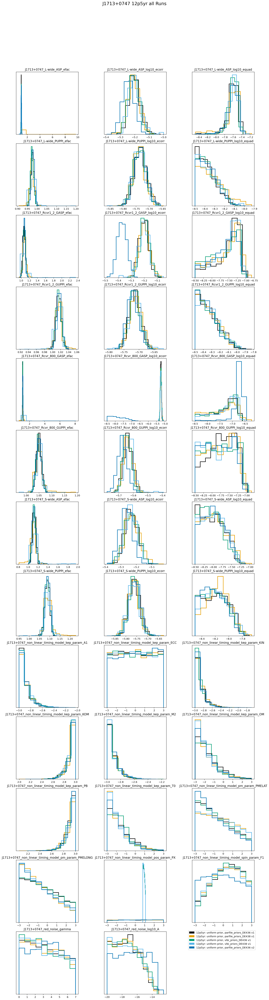

In [27]:
#All Runs
plt_selection_of_dataset('12p5yr')

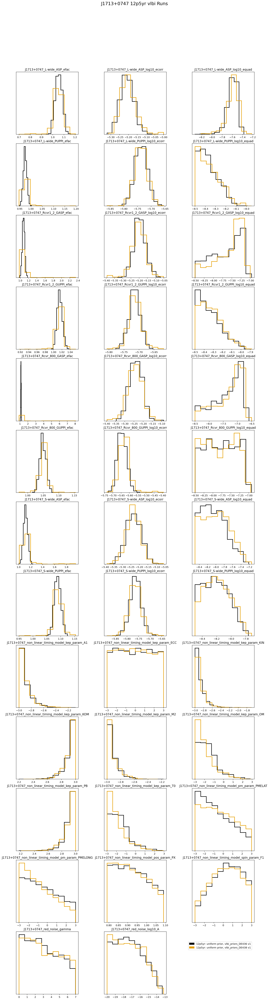

In [28]:
#VLBI Priors
plt_selection_of_dataset('12p5yr',px_prior='vlbi')

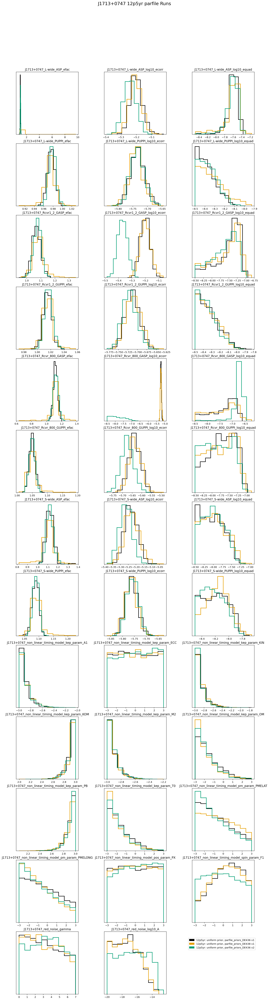

In [29]:
#Non-VLBI Priors
plt_selection_of_dataset('12p5yr',px_prior='parfile')

# Do Plotting with `arviz`
Making `Arviz` dictionaries to plot all chains

In [30]:
az_comb = nltm.get_combined_arviz_obj_from_dict(trimmed_chain_dict,psrs)

(26850, 28)
(26850, 42)
(26850, 40)
(26850, 28)
(26850, 42)
(26850, 40)
(26850, 42)
(26850, 42)
(26850, 42)
(26850, 42)
(26850, 42)
(26850, 28)
(26850, 42)
(26850, 40)
(26850, 28)
(26850, 42)
(26850, 40)


In [31]:
print(az_comb.posterior)

<xarray.Dataset>
Dimensions:                                              (chain: 17, draw: 26850)
Coordinates:
  * chain                                                (chain) int64 0 ... 16
  * draw                                                 (draw) int64 0 ... 26849
Data variables:
    J1713+0747_L_wide_ASP_efac                           (chain, draw) float64 1.153 ... nan
    J1713+0747_L_wide_ASP_log10_ecorr                    (chain, draw) float64 -7.045 ... nan
    J1713+0747_L_wide_ASP_log10_equad                    (chain, draw) float64 -8.212 ... nan
    J1713+0747_Rcvr1_2_GASP_efac                         (chain, draw) float64 1.071 ... 1.125
    J1713+0747_Rcvr1_2_GASP_log10_ecorr                  (chain, draw) float64 -6.273 ... -5.345
    J1713+0747_Rcvr1_2_GASP_log10_equad                  (chain, draw) float64 -7.422 ... -7.602
    J1713+0747_Rcvr_800_GASP_efac                        (chain, draw) float64 1.089 ... 1.144
    J1713+0747_Rcvr_800_GASP_log10_ecorr     

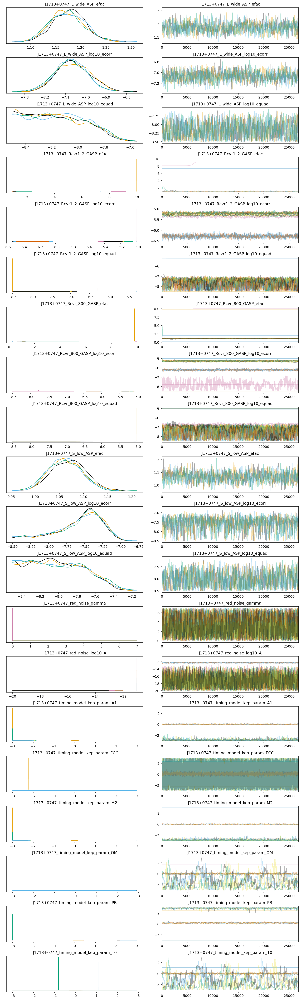

In [32]:
az.plot_trace(az_comb);

# Rescaling the timing parameters to their physical values to properly compare datasets

Have to split into datasets for variable WN
Have to separate by number of parameters, then join

In [33]:
rescaled_5yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'5yr')
az_comb_5yr_rescaled = az.convert_to_inference_data(rescaled_5yr_chain_dict_comb)

5yr not in uniform parfile_priors_DE436 dict_keys(['12p5yr'])
5yr not in uniform parfile_priors_DE438 dict_keys(['12p5yr'])
5yr not in uniform vlbi_priors_DE436 dict_keys(['12p5yr'])
5yr not in uniform vlbi_priors_DE438 dict_keys(['12p5yr'])


In [34]:
rescaled_5yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_5yr_chain_dict_comb,psr_name)
five_yr_chaindirs = []
for chaindir in chaindir_list:
    if '5yr' in chaindir.split('/'):
        five_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


In [35]:
rescaled_9yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'9yr')
az_comb_9yr_rescaled = az.convert_to_inference_data(rescaled_9yr_chain_dict_comb)

9yr not in uniform parfile_priors_DE436 dict_keys(['12p5yr'])
9yr not in uniform parfile_priors_DE438 dict_keys(['12p5yr'])
9yr not in uniform vlbi_priors_DE436 dict_keys(['12p5yr'])
9yr not in uniform vlbi_priors_DE438 dict_keys(['12p5yr'])


In [36]:
rescaled_9yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_9yr_chain_dict_comb,psr_name)
nine_yr_chaindirs = []
for chaindir in chaindir_list:
    if '9yr' in chaindir.split('/'):
        nine_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


In [37]:
rescaled_11yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'11yr')
az_comb_11yr_rescaled = az.convert_to_inference_data(rescaled_11yr_chain_dict_comb)

11yr not in uniform parfile_priors_DE436 dict_keys(['12p5yr'])
11yr not in uniform parfile_priors_DE438 dict_keys(['12p5yr'])
11yr not in uniform vlbi_priors_DE436 dict_keys(['12p5yr'])
11yr not in uniform vlbi_priors_DE438 dict_keys(['12p5yr'])


In [38]:
rescaled_11yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_11yr_chain_dict_comb,psr_name)
eleven_yr_chaindirs = []
for chaindir in chaindir_list:
    if '11yr' in chaindir.split('/'):
        eleven_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


In [39]:
rescaled_12p5yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'12p5yr')
az_comb_12p5yr_rescaled = az.convert_to_inference_data(rescaled_12p5yr_chain_dict_comb)

12p5yr not in uniform vlbi_priors dict_keys(['5yr', '9yr', '11yr'])
12p5yr not in uniform parfile_priors dict_keys(['5yr', '9yr', '11yr'])
12p5yr not in bounded vlbi_priors dict_keys(['5yr', '9yr', '11yr'])
12p5yr not in bounded parfile_priors dict_keys(['5yr', '9yr', '11yr'])


In [40]:
rescaled_12p5yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_12p5yr_chain_dict_comb,psr_name)
twelvep5_yr_chaindirs = []
for chaindir in chaindir_list:
    if '12p5yr' in chaindir.split('/'):
        twelvep5_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


Combine the common parameters for the not donked up datasets

In [41]:
rescaled_chain_dict_5yr_11yr = {}
for param in rescaled_5yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param in rescaled_11yr_chain_dict_comb.keys():
            rescaled_chain_dict_5yr_11yr[param] = np.concatenate((rescaled_5yr_chain_dict_comb[param],
                                                                  rescaled_11yr_chain_dict_comb[param]),axis=0)

In [42]:
#az.summary(az_comb_5yr_rescaled)

In [43]:
#az.summary(az_comb_9yr_rescaled)

In [44]:
def plt_all_rescaled_dataset(core_list,chaindir_list,dataset):
    core_kwargs = {'hist':True, 'ncols':4, 'title_y':1.03,
               'suptitle':'{} 11yr All Runs'.format(psrlist[0]),
               'bins':10,'hist_kwargs':dict(fill=False),'linewidth':2.}
    misc_kwargs = {'legend_on':True,'legend_loc':(.7,0.05)}
    priors = []
    px_priors = []
    for p in chain_dict.keys():
        for px_p in chain_dict[p].keys():
            if dataset in chain_dict[p][px_p].keys():
                if p not in priors:
                    priors.append(p)
                if px_p not in px_priors:
                    px_priors.append(px_p)
    nltm.plot_common_chains(core_list,chaindir_list,priors,px_priors,dataset,
                            plot_kwargs=core_kwargs,misc_kwargs=misc_kwargs)

## 5yr Plots

`la_forge` plots, then `arviz`

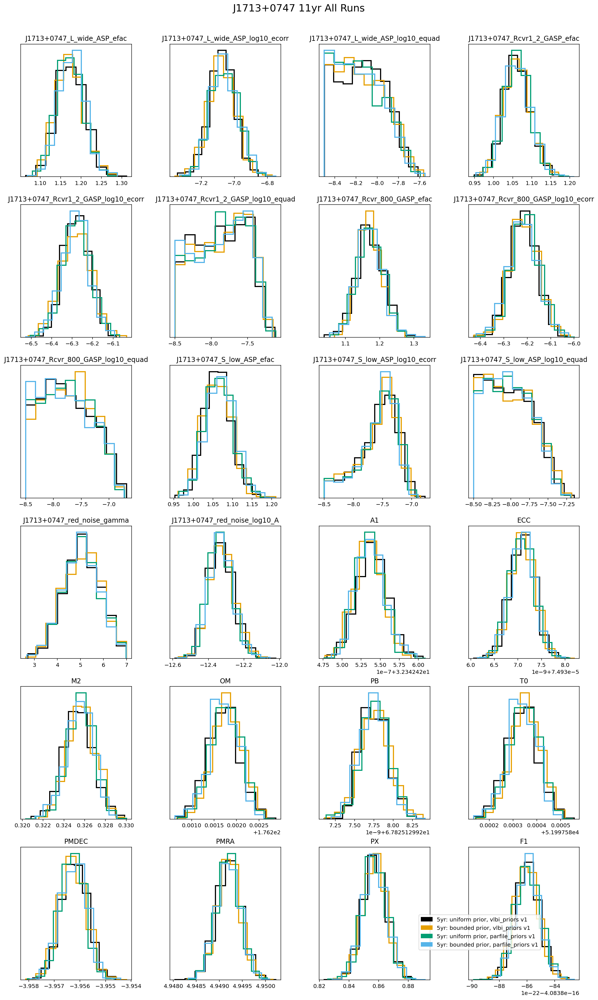

In [45]:
#All Runs
plt_all_rescaled_dataset(rescaled_5yr_core_list_comb,five_yr_chaindirs,'5yr')

In [46]:
white_pars_5yr = []
other_pars_5yr = []
for param in rescaled_5yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_5yr.append(param)
        else:
            other_pars_5yr.append(param)

White Noise Parameters

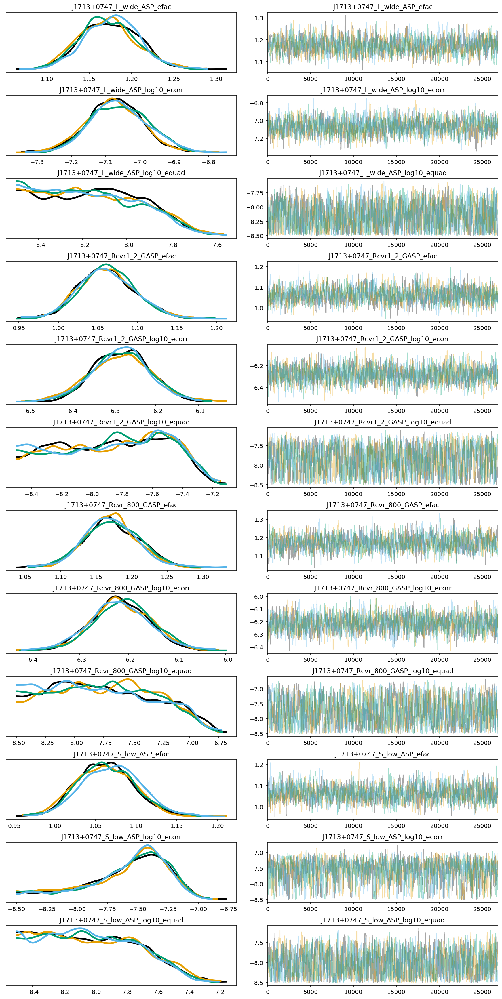

In [47]:
az.plot_trace(az_comb_5yr_rescaled,var_names=white_pars_5yr,plot_kwargs={'linewidth':3});

Red + Timing Parameters

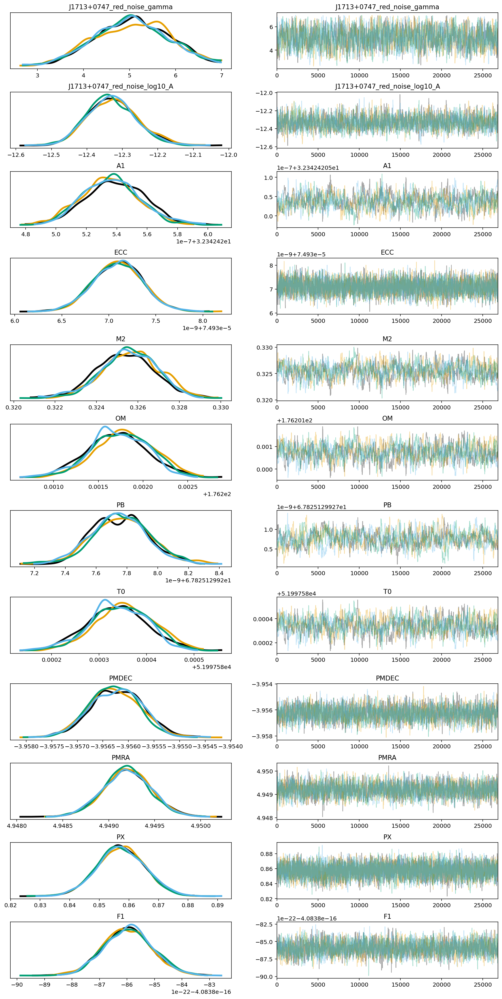

In [48]:
az.plot_trace(az_comb_5yr_rescaled,var_names=other_pars_5yr,plot_kwargs={'linewidth':3});

## 9yr Plots

`la_forge` plots, then `arviz`

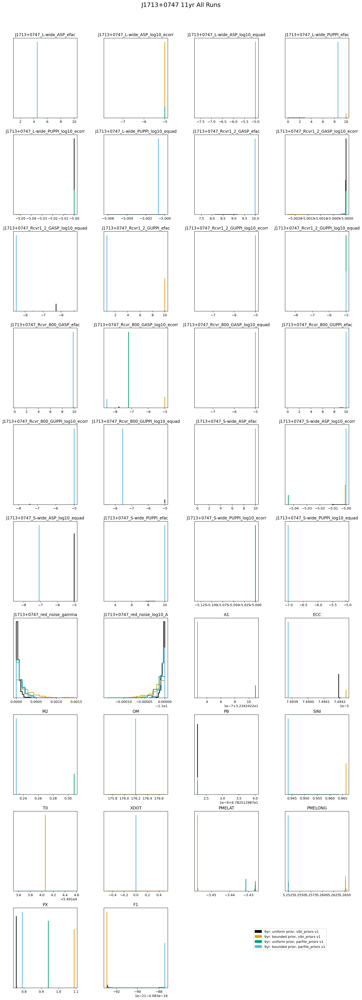

In [49]:
#All Runs
plt_all_rescaled_dataset(rescaled_9yr_core_list_comb,nine_yr_chaindirs,'9yr')

In [50]:
white_pars_9yr = []
other_pars_9yr = []
for param in rescaled_9yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_9yr.append(param)
        else:
            other_pars_9yr.append(param)

White noise parameters

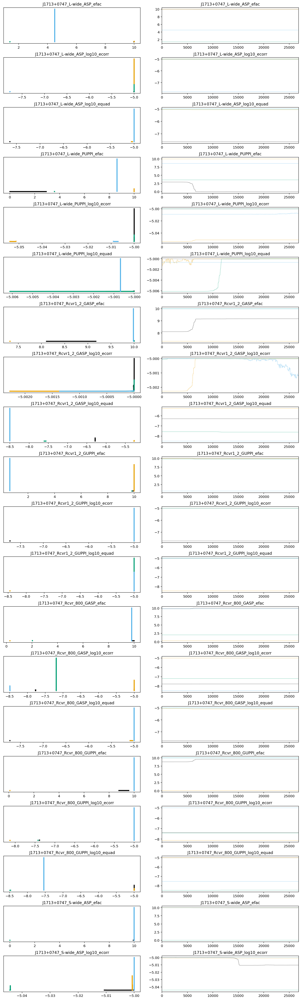

In [51]:
az.plot_trace(az_comb_9yr_rescaled,var_names=white_pars_9yr,plot_kwargs={'linewidth':3});

Red + Timing Parameters

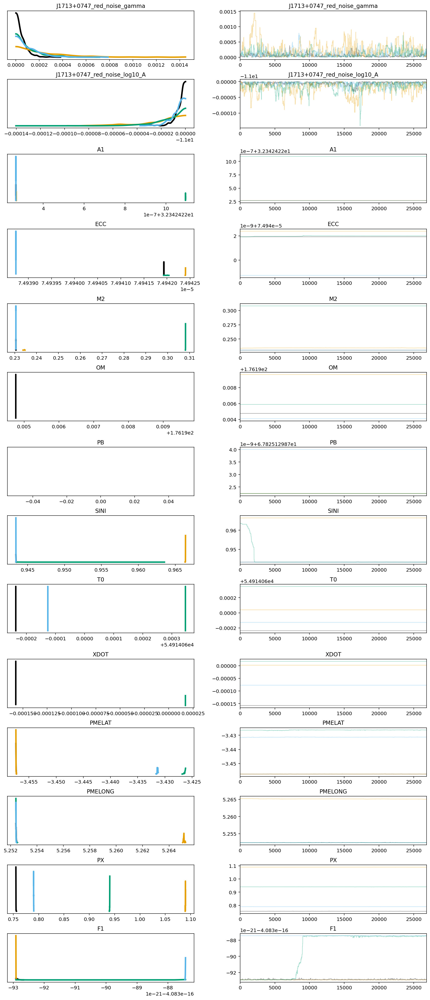

In [52]:
az.plot_trace(az_comb_9yr_rescaled,var_names=other_pars_9yr,plot_kwargs={'linewidth':3});

## 11yr Plots

`la_forge` plots, then `arviz`

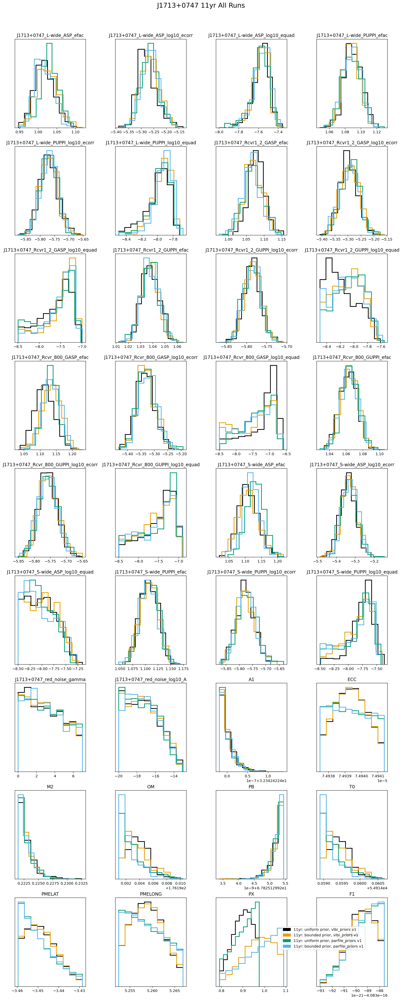

In [53]:
#All Runs
plt_all_rescaled_dataset(rescaled_11yr_core_list_comb,eleven_yr_chaindirs,'11yr')

In [54]:
white_pars_11yr = []
other_pars_11yr = []
for param in rescaled_11yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_11yr.append(param)
        else:
            other_pars_11yr.append(param)

White noise parameters

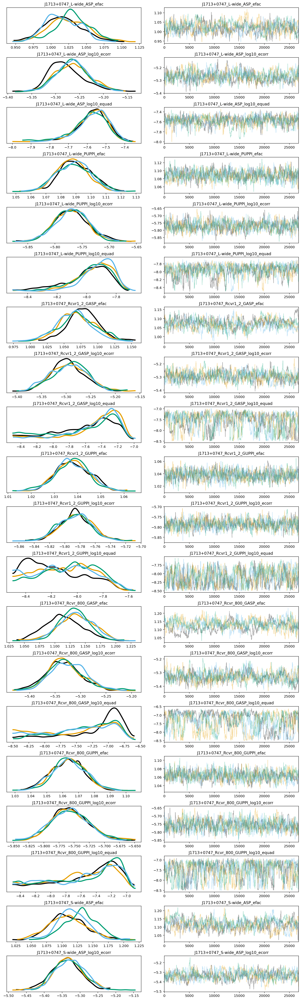

In [55]:
az.plot_trace(az_comb_11yr_rescaled,var_names=white_pars_11yr,plot_kwargs={'linewidth':3});

Red + Timing Parameters

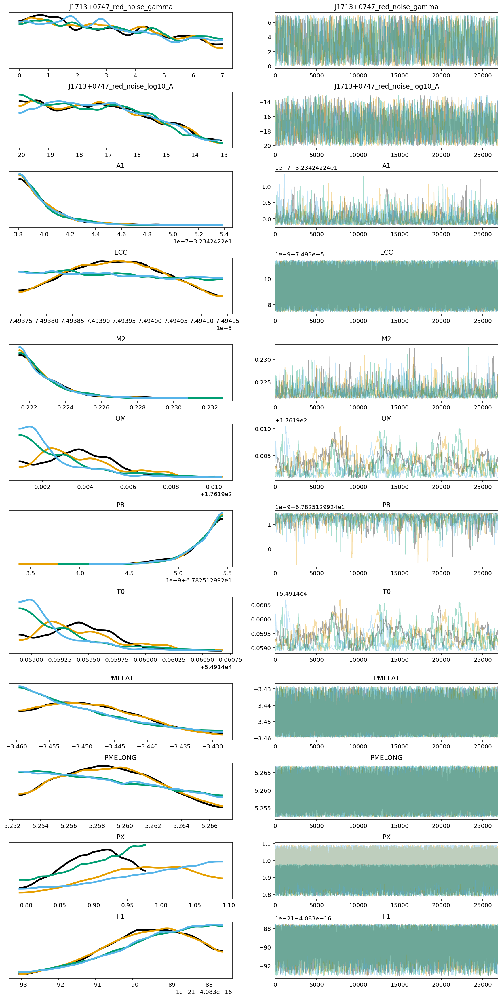

In [56]:
az.plot_trace(az_comb_11yr_rescaled,var_names=other_pars_11yr,plot_kwargs={'linewidth':3});

## 12.5yr Plots

`la_forge` plots, then `arviz`

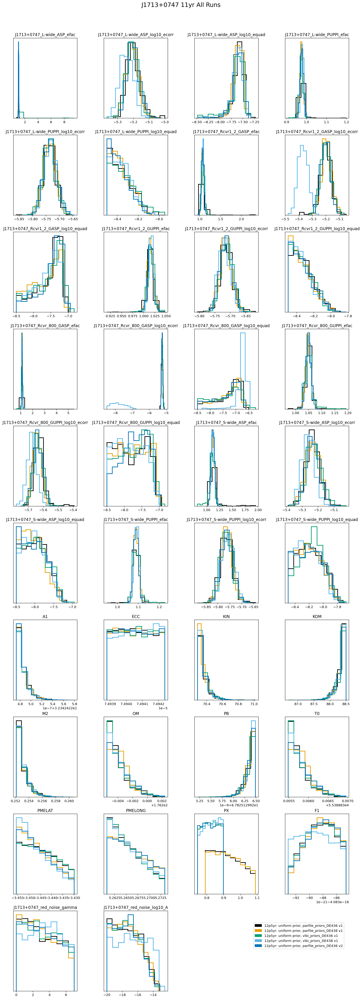

In [57]:
#All Runs
plt_all_rescaled_dataset(rescaled_12p5yr_core_list_comb,twelvep5_yr_chaindirs,'12p5yr')

In [58]:
white_pars_12p5yr = []
other_pars_12p5yr = []
for param in rescaled_12p5yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_12p5yr.append(param)
        else:
            other_pars_12p5yr.append(param)

White noise parameters

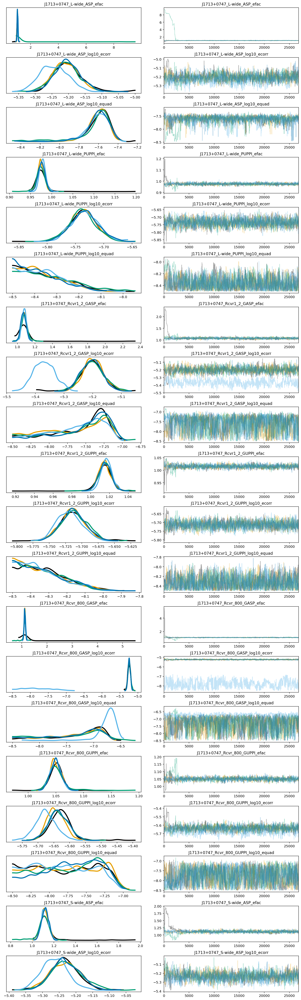

In [59]:
az.plot_trace(az_comb_12p5yr_rescaled,var_names=white_pars_12p5yr,plot_kwargs={'linewidth':3});

Red + Timing parameters

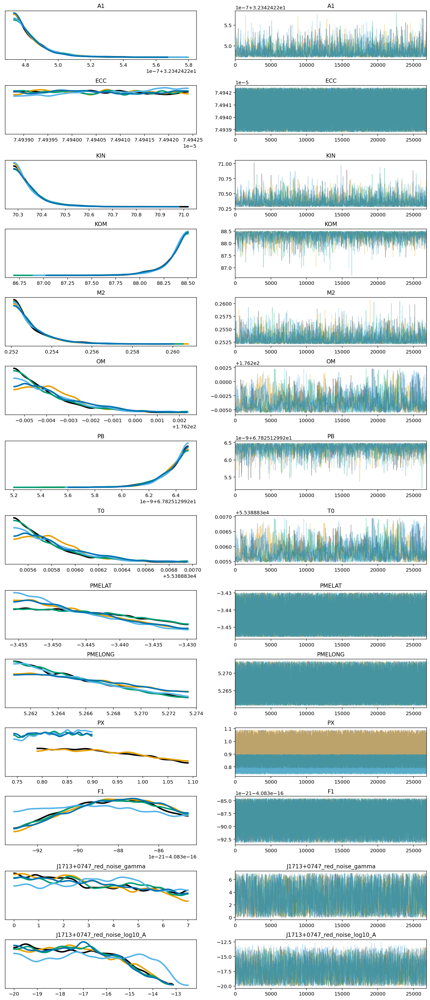

In [60]:
az.plot_trace(az_comb_12p5yr_rescaled,var_names=other_pars_12p5yr,plot_kwargs={'linewidth':3});

## Combined Plots

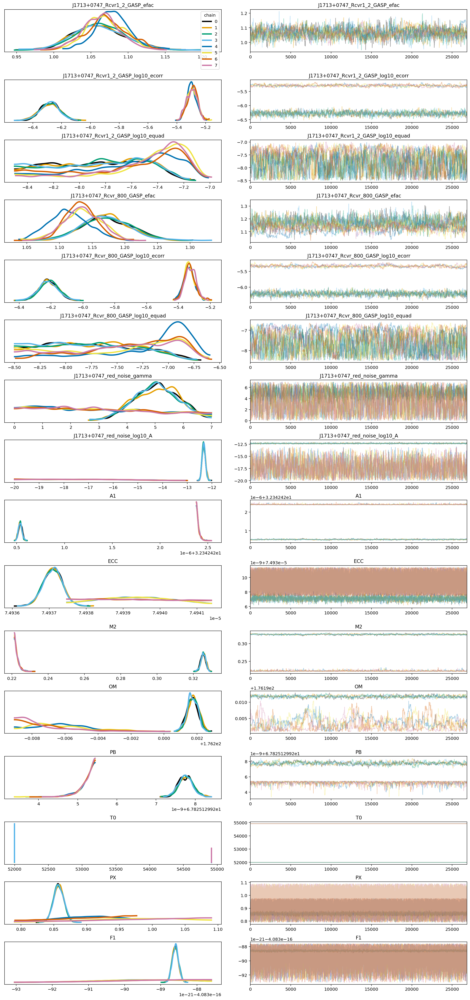

In [61]:
az.plot_trace(rescaled_chain_dict_5yr_11yr,legend=True,figsize=(15,2*len(rescaled_chain_dict_5yr_11yr.keys())),
             plot_kwargs={'linewidth':3});

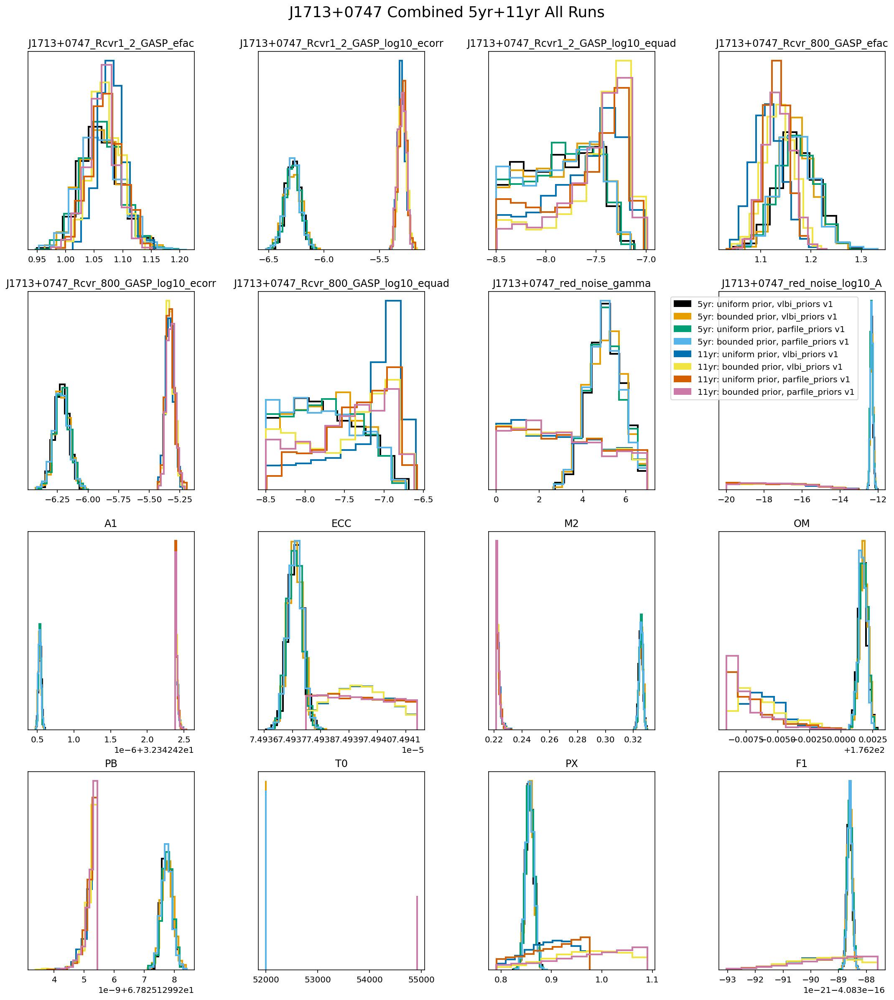

In [62]:
#All Runs
core_kwargs = {'hist':True, 'ncols':4, 'title_y':1.03,
               'suptitle':'{} Combined 5yr+11yr All Runs'.format(psrlist[0]),
               'bins':10,'hist_kwargs':dict(fill=False),'linewidth':2.}
misc_kwargs = {'legend_on':True,'legend_loc':(.75,.6)}
datasets = ['5yr','11yr']
priors = []
px_priors = []
for p in chain_dict.keys():
    for px_p in chain_dict[p].keys():
        for dataset in datasets:
            if dataset in chain_dict[p][px_p].keys():
                if p not in priors:
                    priors.append(p)
                if px_p not in px_priors:
                    px_priors.append(px_p)
nltm.plot_common_chains((rescaled_5yr_core_list_comb + rescaled_11yr_core_list_comb),
                        (five_yr_chaindirs+eleven_yr_chaindirs),priors,px_priors,datasets,
                        plot_kwargs=core_kwargs,misc_kwargs=misc_kwargs)

# PX Only

In [63]:
tmp = rescaled_5yr_core_list_comb + rescaled_11yr_core_list_comb
px_array = []
for tmp_core in tmp:
    px_array.append(tmp_core.get_param('PX',to_burn=False))

In [64]:
mus = []
lb = []
ub = []
for dataset in pardict.keys():
    if dataset in ['5yr','11yr']:
        for parvals in pardict[dataset].values():
            mus.append(parvals['PX']['val'])
            lb.append(parvals['PX']['val']-parvals['PX']['val']*parvals['PX']['err'])
            ub.append(parvals['PX']['val']+parvals['PX']['val']*parvals['PX']['err'])
mus.append(tm_val)

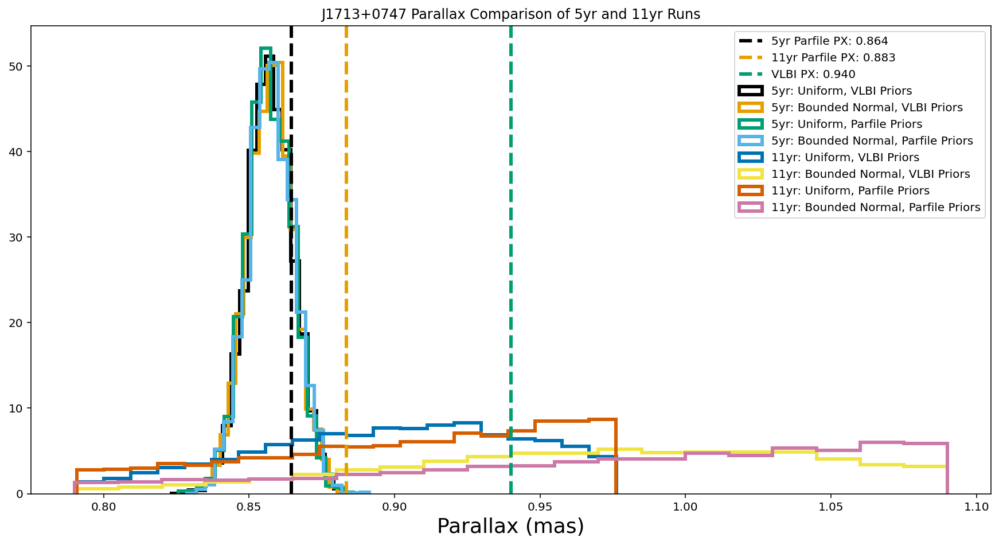

In [65]:
fig,ax = plt.subplots(1,1,figsize=(15,7.5))
hist_kwargs = {'fill':False,'bins':20,'linewidth':3.,'density':True,'histtype':'step'}
legend_list = ['5yr: Uniform, VLBI Priors','5yr: Bounded Normal, VLBI Priors',
               '5yr: Uniform, Parfile Priors','5yr: Bounded Normal, Parfile Priors',
               '11yr: Uniform, VLBI Priors','11yr: Bounded Normal, VLBI Priors',
               '11yr: Uniform, Parfile Priors','11yr: Bounded Normal, Parfile Priors']

for i,px in enumerate(px_array):
    hist_kwargs['Color'] = 'C{}'.format(i)
    hist_kwargs['label'] = legend_list[i]
    ax.hist(px,**hist_kwargs);

legend_list_2 = ['5yr Parfile PX','11yr Parfile PX','VLBI PX']
for i,mu in enumerate(mus):
    ax.axvline(x=mu,linestyle='--',linewidth=3,color='C{}'.format(i),label=legend_list_2[i]+': %.3f' %mu)
ax.set_xlabel(r'Parallax (mas)',fontsize=18)
plt.title('{} Parallax Comparison of 5yr and 11yr Runs'.format(psrlist[0]))
plt.legend()
#plt.savefig('./Figures/{}_px_comp.png'.format(psrlist[0]),dpi=300,bbox_inches='tight')
plt.show()